In [5]:
import os
import cv2

import numpy as np

In [6]:
IMAGE_PATH = "/home/enfycius/Documents/LH_Dataset/Semantic_Segmentation/imgs/"
LABEL_PATH = "/home/enfycius/Documents/LH_Dataset/Semantic_Segmentation/labels/"
SAVE_PATH = "/home/enfycius/Documents/LH_Dataset/Semantic_Segmentation/imgs_resize/"

In [7]:
def get_files(path) -> list[list[str]]:
    files = []
    files_path = []

    for dirname, _, filenames in os.walk(path):
        for filename in filenames:
            files.append(filename)
            files_path.append(dirname + filename)

    return [files, files_path]

In [8]:
def resize_imgs(path = IMAGE_PATH, label_path = LABEL_PATH, save_path = SAVE_PATH):
    [files, files_path] = get_files(path)
    
    current = 0

    for file, file_path in zip(files, files_path):
        img = cv2.imread(file_path, cv2.IMREAD_UNCHANGED)
        img_label = cv2.imread(label_path + file, cv2.IMREAD_UNCHANGED)

        img = cv2.resize(img, (img_label.shape[1], img_label.shape[0]))
        
        cv2.imwrite(save_path + file, img)

        current = current + 1

        print(f"{current} image of total {len(files)} images")
        print(save_path + file)

In [9]:
resize_imgs()

1 image of total 166 images
/home/enfycius/Documents/LH_Dataset/Semantic_Segmentation/imgs_resize/0340.png
2 image of total 166 images
/home/enfycius/Documents/LH_Dataset/Semantic_Segmentation/imgs_resize/0003.png
3 image of total 166 images
/home/enfycius/Documents/LH_Dataset/Semantic_Segmentation/imgs_resize/0194.png
4 image of total 166 images
/home/enfycius/Documents/LH_Dataset/Semantic_Segmentation/imgs_resize/0306.png
5 image of total 166 images
/home/enfycius/Documents/LH_Dataset/Semantic_Segmentation/imgs_resize/0270.png
6 image of total 166 images
/home/enfycius/Documents/LH_Dataset/Semantic_Segmentation/imgs_resize/0101.png
7 image of total 166 images
/home/enfycius/Documents/LH_Dataset/Semantic_Segmentation/imgs_resize/0322.png
8 image of total 166 images
/home/enfycius/Documents/LH_Dataset/Semantic_Segmentation/imgs_resize/0232.png
9 image of total 166 images
/home/enfycius/Documents/LH_Dataset/Semantic_Segmentation/imgs_resize/0117.png
10 image of total 166 images
/home/en

In [10]:
SAVE_PATH = "/home/enfycius/Documents/LH_Dataset/Semantic_Segmentation/labels_uniform/"

In [11]:
def uniform_labels(path = LABEL_PATH, save_path = SAVE_PATH):
    [files, files_path] = get_files(path)
    
    current = 0

    for file, file_path in zip(files, files_path):
        img = cv2.imread(file_path, cv2.IMREAD_UNCHANGED)

        ret, thresh1 = cv2.threshold(img, 0.1, 1, cv2.THRESH_BINARY)
        
        cv2.imwrite(save_path + file, thresh1)

        current = current + 1

        print(f"{current} image of total {len(files)} images")
        print(save_path + file)

In [12]:
uniform_labels()

1 image of total 166 images
/home/enfycius/Documents/LH_Dataset/Semantic_Segmentation/labels_uniform/0340.png
2 image of total 166 images
/home/enfycius/Documents/LH_Dataset/Semantic_Segmentation/labels_uniform/0003.png
3 image of total 166 images
/home/enfycius/Documents/LH_Dataset/Semantic_Segmentation/labels_uniform/0194.png
4 image of total 166 images
/home/enfycius/Documents/LH_Dataset/Semantic_Segmentation/labels_uniform/0306.png
5 image of total 166 images
/home/enfycius/Documents/LH_Dataset/Semantic_Segmentation/labels_uniform/0270.png
6 image of total 166 images
/home/enfycius/Documents/LH_Dataset/Semantic_Segmentation/labels_uniform/0101.png
7 image of total 166 images
/home/enfycius/Documents/LH_Dataset/Semantic_Segmentation/labels_uniform/0322.png
8 image of total 166 images
/home/enfycius/Documents/LH_Dataset/Semantic_Segmentation/labels_uniform/0232.png
9 image of total 166 images
/home/enfycius/Documents/LH_Dataset/Semantic_Segmentation/labels_uniform/0117.png
10 image o

In [13]:
import matplotlib.pyplot as plt

In [18]:
def path_to_img(paths, flag=cv2.IMREAD_COLOR):
    imgs = []

    for path in paths:
        imgs.append(cv2.imread(path, flag))
        
    return imgs

In [22]:
def plot_imgs_labels(imgs, masks, paths, n_row = 10, n_col = 10, figsize = (12, 12), bottom = 0.1, \
                right = 0.8, top = 0.9):
    
    _, axs = plt.subplots(n_row, n_col, figsize=figsize)
    axs = axs.flatten()

    for img, masks, path, ax in zip(imgs, masks, paths, axs):
        ax.title.set_text(os.path.split(path)[1])
        ax.imshow(img)
        ax.imshow(masks, alpha=0.6)

    plt.subplots_adjust(bottom = bottom, right = right, top = top)
    plt.show()

In [25]:
paths = get_files(IMAGE_PATH)[1]

img_paths = paths
label_paths = get_files(LABEL_PATH)[1]

imgs = path_to_img(paths = img_paths, flag = cv2.IMREAD_COLOR)
masks = path_to_img(paths = label_paths, flag = cv2.IMREAD_GRAYSCALE)

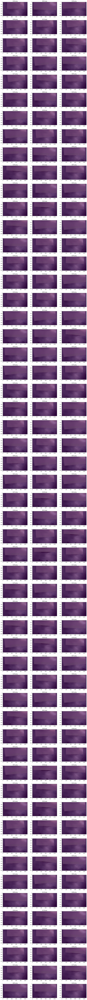

In [28]:
plot_imgs_labels(imgs = imgs, \
                 masks = masks, \
            paths = paths, \
            n_row = len(imgs) // 3, \
            n_col = 3, \
            figsize = (20, 200))